# Maud CNO Analysis

In [185]:
# Imports

import os
import pickle

import matplotlib.pyplot as plt
import numpy as np
import matplotlib.path as mpath

from matplotlib.colors import Normalize
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.gridspec import GridSpec, GridSpecFromSubplotSpec
# from processing_TowerCoordinates import *

In [186]:
# Take one mouse as an example

path_to_data_folder = '/home/david/MyLocalData/Maud/' # Maud work computer
# path_to_data_folder = 'C:/Users/mauds/Documents' # Maud personal computer
pattern_of_MOU_Folders = os.path.join(path_to_data_folder, "MOU*")

mice_list: list[str] = ["MOU3867","MOU4551","MOU4623","MOU4562","MOU4560","MOU4623","MOU4624","MOU4552","MOU4563","MOU4561","MOU4692","MOU4694","MOU4695","MOU4696","MOU4698","MOU4703","MOU4704","MOU4172","MOU4175","MOU4183","MOU4185"]
UL_Gq_D1_DLS: list[str] = ["MOU4623","MOU4551"]
UL_Gq_D2_DLS: list[str] = ["MOU4562","MOU4560","MOU4696","MOU4694"]
UL_Gq_D1_DMS: list[str] = ["MOU4624","MOU4552","MOU4703","MOU4704","MOU3867"]
UL_Gq_D2_DMS: list[str] = ["MOU4563","MOU4561","MOU4695","MOU4698","MOU4692"]
UL_Gq_D1_dS: list[str] = ["MOU4183","MOU4185"]
UL_Gq_D2_dS: list[str] = ["MOU4172","MOU4175"]

session_list = {}
for mouse in mice_list:
    mouse_folder = os.path.join(path_to_data_folder,mouse)
    session_list[mouse] = sorted([name for name in os.listdir(mouse_folder)
                           if os.path.isdir(os.path.join(mouse_folder, name))
                           and name.startswith('MOU')])
    nb_sessions = len(session_list[mouse])
    print(f'Hello, I\'m {mouse}! I have foraged for {nb_sessions} sessions')
    # print(session_list[mouse], '\n')

Hello, I'm MOU3867! I have foraged for 58 sessions
Hello, I'm MOU4551! I have foraged for 46 sessions
Hello, I'm MOU4623! I have foraged for 46 sessions
Hello, I'm MOU4562! I have foraged for 46 sessions
Hello, I'm MOU4560! I have foraged for 46 sessions
Hello, I'm MOU4623! I have foraged for 46 sessions
Hello, I'm MOU4624! I have foraged for 46 sessions
Hello, I'm MOU4552! I have foraged for 46 sessions
Hello, I'm MOU4563! I have foraged for 46 sessions
Hello, I'm MOU4561! I have foraged for 46 sessions
Hello, I'm MOU4692! I have foraged for 46 sessions
Hello, I'm MOU4694! I have foraged for 46 sessions
Hello, I'm MOU4695! I have foraged for 46 sessions
Hello, I'm MOU4696! I have foraged for 46 sessions
Hello, I'm MOU4698! I have foraged for 46 sessions
Hello, I'm MOU4703! I have foraged for 46 sessions
Hello, I'm MOU4704! I have foraged for 46 sessions
Hello, I'm MOU4172! I have foraged for 46 sessions
Hello, I'm MOU4175! I have foraged for 46 sessions
Hello, I'm MOU4183! I have fora

In [187]:
folder_path_mouse_to_process=os.path.join(path_to_data_folder,mice_list[0])
print(folder_path_mouse_to_process)

session_control_first=session_list[mice_list[0]][28]
print(session_control_first)

session_CNO_first=session_list[mice_list[0]][31]
print(session_CNO_first)

session_control_second = session_list[mice_list[0]][33]
print(session_control_second)

session_CNO_second = session_list[mice_list[0]][36]
print(session_CNO_second)

# session_control_third = session_list[mice_list[0]][41]
# print(session_control_third)

# session_CNO_third = session_list[mice_list[0]][44]
# print(session_CNO_third)


/home/david/MyLocalData/Maud/MOU3867
MOU3867_20230207-1011
MOU3867_20230208-1718
MOU3867_20230209-1639
MOU3867_20230211-1041


In [188]:
# # Retrieve all data from pickle for all sessions
# # TO DO : Does not work for third session, see that problem later

# # Définir des dictionnaires pour stocker les résultats par session
# X_positions_dict = {}
# Y_positions_dict = {}
# total_distances = {}
# average_speeds = {}
# distances_dict = {}
# speeds_dict = {}
# angular_speeds_dict = {}
# all_epochs_dict = {}
# traject_time_dict = {}
# run_around_tower_results_dict = {}
# runs_around_tower_dict = {}
# trapezes_coordinates_dict = {}
# towers_coordinates_dict = {}
# runs_between_towers_dict = {}
# exploratory_runs_dict = {}

# # Définir les indices de sessions
# session_indices = {
#     "control_first": 16,
#     "CNO_first": 20,
#     "control_second": 26,
#     "CNO_second": 30,
#     "control_third": 40,
#     "CNO_third": 42
# }

# # Paire de sessions à analyser
# session_pairs = [
#     ("control_first", "CNO_first"),
#     ("control_second", "CNO_second"),
#     ("control_third","CNO_third")
# ]

# mouse = mice_list[0]
# # folder_path_mouse_to_process = os.path.join(path_to_data_folder, mouse)

# # Obtenir les sessions pour la souris spécifiée
# # for mouse in mice_list:
    

# # Itérer sur chaque paire de sessions
# for control_session, CNO_session in session_pairs:
#     for session_type in (control_session, CNO_session):
#         # Identifier la session à traiter
#         session_to_process = session_list[mouse][session_indices[session_type]]
        
#         # Chemin vers le fichier pickle
#         output_pickle_filepath = os.path.join(folder_path_mouse_to_process, session_to_process, f"{session_to_process}_basic_processing_output.pickle")
        
#         # Vérifier que le fichier existe et n'est pas vide
#         if not os.path.exists(output_pickle_filepath):
#             print(f"Erreur : le fichier {output_pickle_filepath} n'existe pas.")
#             continue
#         elif os.path.getsize(output_pickle_filepath) == 0:
#             print(f"Erreur : le fichier {output_pickle_filepath} est vide.")
#             continue
        
#         # Charger le fichier pickle
#         try:
#             with open(output_pickle_filepath, 'rb') as f:
#                 data = pickle.load(f)
#         except EOFError:
#             print(f"Erreur de lecture : le fichier {output_pickle_filepath} semble être corrompu.")
#             continue

#         # Extraire les données spécifiques
#         X_positions_cm = data['positions'][0]
#         Y_positions_cm = data['positions'][1]
#         average_speed = data['average_speed']
#         distances = data['distances']
#         speeds = data['speeds']
#         angular_speeds = data['angular_speeds']
#         all_epochs = data['all_epochs']
#         traject_time = data['timeofframes']
#         run_around_tower_results = data['run_around_tower_sessionresult']
#         runs_around_tower = all_epochs['run_around_tower']
#         runs_between_towers = all_epochs['run_between_towers']
#         exploratory_runs = all_epochs['exploratory_run']
#         trapezes_coordinates = data['all_trapezes_coordinates_cm']
#         towers_coordinates = data['towers_coordinates_cm']
        
#         # Calcul de la distance totale en mètres
#         total_distance = np.sum(distances) / 100
        
#         # Stocker les résultats dans les dictionnaires
#         X_positions_dict[session_type] = X_positions_cm
#         Y_positions_dict[session_type] = Y_positions_cm
#         total_distances[session_type] = total_distance
#         average_speeds[session_type] = average_speed
#         distances_dict[session_type] = distances
#         speeds_dict[session_type] = speeds
#         angular_speeds_dict[session_type] = angular_speeds
#         all_epochs_dict[session_type] = all_epochs
#         traject_time_dict[session_type] = traject_time
#         run_around_tower_results_dict[session_type] = run_around_tower_results
#         runs_around_tower_dict[session_type] = runs_around_tower
#         trapezes_coordinates_dict[session_type] = trapezes_coordinates
#         towers_coordinates_dict[session_type] = towers_coordinates
#         runs_between_towers_dict[session_type] = runs_between_towers
#         exploratory_runs_dict[session_type] = exploratory_runs

        # Affichage des résultats
        # print(f"Session: {session_type}, Distance totale parcourue: {total_distance} m")

# # Affichage final des dictionnaires contenant les distances pour chaque session
# print("\nTotal distances par session:")
# print(total_distances)

# print("\nAverage speeds par session:")
# print(average_speeds)

# print("\nDistances par session:")
# print(distances_dict)

# print("\nSpeeds par session:")
# print(speeds_dict)

# print("\nAngular speeds par session:")
# print(angular_speeds_dict)

# print("\nAll epochs par session:")
# print(all_epochs_dict)

# print("\nTraject time par session:")
# print(traject_time_dict)

# print("\nResults of runs around tower per session:")
# print(run_around_tower_results_dict)

# print("\nRuns around tower per session:")
# print(runs_around_tower_dict)

# print("\nTrapeze coordinates per session:")
# print(trapezes_coordinates_dict)

# print("\nTowers coordinates per session:")
# print(towers_coordinates_dict)

In [189]:
# Définir des dictionnaires pour stocker les résultats par session et par souris
X_positions_dict = {}
Y_positions_dict = {}
total_distances = {}
average_speeds = {}
distances_dict = {}
speeds_dict = {}
angular_speeds_dict = {}
all_epochs_dict = {}
traject_time_dict = {}
run_around_tower_results_dict = {}
runs_around_tower_dict = {}
trapezes_coordinates_dict = {}
towers_coordinates_dict = {}
runs_between_towers_dict = {}
exploratory_runs_dict = {}

# Définir les indices de sessions
session_indices = {
    "control_first": 16,
    "CNO_first": 20,
    "control_second": 26,
    "CNO_second": 30,
    "control_third": 40,
    "CNO_third": 42
}

# Paire de sessions à analyser
session_pairs = [
    ("control_first", "CNO_first"),
    ("control_second", "CNO_second"),
    ("control_third","CNO_third")
]

# Boucle pour traiter chaque souris
for mouse in mice_list:
    
    # Initialiser les sous-dictionnaires pour chaque souris
    X_positions_dict[mouse] = {}
    Y_positions_dict[mouse] = {}
    total_distances[mouse] = {}
    average_speeds[mouse] = {}
    distances_dict[mouse] = {}
    speeds_dict[mouse] = {}
    angular_speeds_dict[mouse] = {}
    all_epochs_dict[mouse] = {}
    traject_time_dict[mouse] = {}
    run_around_tower_results_dict[mouse] = {}
    runs_around_tower_dict[mouse] = {}
    trapezes_coordinates_dict[mouse] = {}
    towers_coordinates_dict[mouse] = {}
    runs_between_towers_dict[mouse] = {}
    exploratory_runs_dict[mouse] = {}
    
    # Itérer sur chaque paire de sessions
    for control_session, CNO_session in session_pairs:
        for session_type in (control_session, CNO_session):
            # Identifier la session à traiter
            session_index = session_indices[session_type]
            
            # Vérifier que l'indice de session existe dans la liste des sessions de la souris
            if session_index >= len(session_list[mouse]):
                print(f"Erreur : l'indice {session_index} dépasse le nombre de sessions pour {mouse}.")
                continue
            
            session_to_process = session_list[mouse][session_index]
            
            # Chemin vers le fichier pickle
            output_pickle_filepath = os.path.join(path_to_data_folder, mouse, session_to_process, f"{session_to_process}_basic_processing_output.pickle")
            
            # Vérifier que le fichier existe et n'est pas vide
            if not os.path.exists(output_pickle_filepath):
                print(f"Erreur : le fichier {output_pickle_filepath} n'existe pas.")
                continue
            elif os.path.getsize(output_pickle_filepath) == 0:
                print(f"Erreur : le fichier {output_pickle_filepath} est vide.")
                continue
            
            # Charger le fichier pickle
            try:
                with open(output_pickle_filepath, 'rb') as f:
                    data = pickle.load(f)
            except EOFError:
                print(f"Erreur de lecture : le fichier {output_pickle_filepath} semble être corrompu.")
                continue

            # Extraire les données spécifiques
            X_positions_cm = data['positions'][0]
            Y_positions_cm = data['positions'][1]
            average_speed = data['average_speed']
            distances = data['distances']
            speeds = data['speeds']
            angular_speeds = data['angular_speeds']
            all_epochs = data['all_epochs']
            traject_time = data['timeofframes']
            run_around_tower_results = data['run_around_tower_sessionresult']
            runs_around_tower = all_epochs['run_around_tower']
            runs_between_towers = all_epochs['run_between_towers']
            exploratory_runs = all_epochs['exploratory_run']
            trapezes_coordinates = data['all_trapezes_coordinates_cm']
            towers_coordinates = data['towers_coordinates_cm']
            
            # Calcul de la distance totale en mètres
            total_distance = np.sum(distances) / 100
            
            # Stocker les résultats dans les dictionnaires pour chaque session et chaque souris
            X_positions_dict[mouse][session_type] = X_positions_cm
            Y_positions_dict[mouse][session_type] = Y_positions_cm
            total_distances[mouse][session_type] = total_distance
            average_speeds[mouse][session_type] = average_speed
            distances_dict[mouse][session_type] = distances
            speeds_dict[mouse][session_type] = speeds
            angular_speeds_dict[mouse][session_type] = angular_speeds
            all_epochs_dict[mouse][session_type] = all_epochs
            traject_time_dict[mouse][session_type] = traject_time
            run_around_tower_results_dict[mouse][session_type] = run_around_tower_results
            runs_around_tower_dict[mouse][session_type] = runs_around_tower
            trapezes_coordinates_dict[mouse][session_type] = trapezes_coordinates
            towers_coordinates_dict[mouse][session_type] = towers_coordinates
            runs_between_towers_dict[mouse][session_type] = runs_between_towers
            exploratory_runs_dict[mouse][session_type] = exploratory_runs

# Affichage final des dictionnaires contenant les distances pour chaque session
print("\nTotal distances par session:")
print(total_distances)

print("\nAverage speeds par session:")
print(average_speeds)

print("\nDistances par session:")
print(distances_dict)

print("\nSpeeds par session:")
print(speeds_dict)

print("\nAngular speeds par session:")
print(angular_speeds_dict)

print("\nAll epochs par session:")
print(all_epochs_dict)

print("\nTraject time par session:")
print(traject_time_dict)

print("\nResults of runs around tower per session:")
print(run_around_tower_results_dict)

print("\nRuns around tower per session:")
print(runs_around_tower_dict)

print("\nTrapeze coordinates per session:")
print(trapezes_coordinates_dict)

print("\nTowers coordinates per session:")
print(towers_coordinates_dict)


Total distances par session:
{'MOU3867': {'control_first': 105.47195466008283, 'CNO_first': 93.78291276446565, 'control_second': 97.83571088768149, 'CNO_second': 79.13493777251298, 'control_third': 94.44294543310966, 'CNO_third': 72.64642320447685}, 'MOU4551': {'control_first': 97.09605517708523, 'CNO_first': 62.420136887911184, 'control_second': 83.81977213418442, 'CNO_second': 77.09014334845341, 'control_third': 130.49042894046724, 'CNO_third': 132.56063616107184}, 'MOU4623': {'control_first': 117.19107755121931, 'CNO_first': 50.6370476555629, 'control_second': 108.02312886854394, 'CNO_second': 43.3831353526187, 'control_third': 125.92230672685442, 'CNO_third': 44.68022176762063}, 'MOU4562': {'control_first': 105.93504334018081, 'CNO_first': 93.16524454883145, 'control_second': 97.2833654914069, 'CNO_second': 117.81763431293777, 'control_third': 118.9830900502569, 'CNO_third': 86.74864775777105}, 'MOU4560': {'control_first': 111.09187917852577, 'CNO_first': 89.5758985864123, 'contro

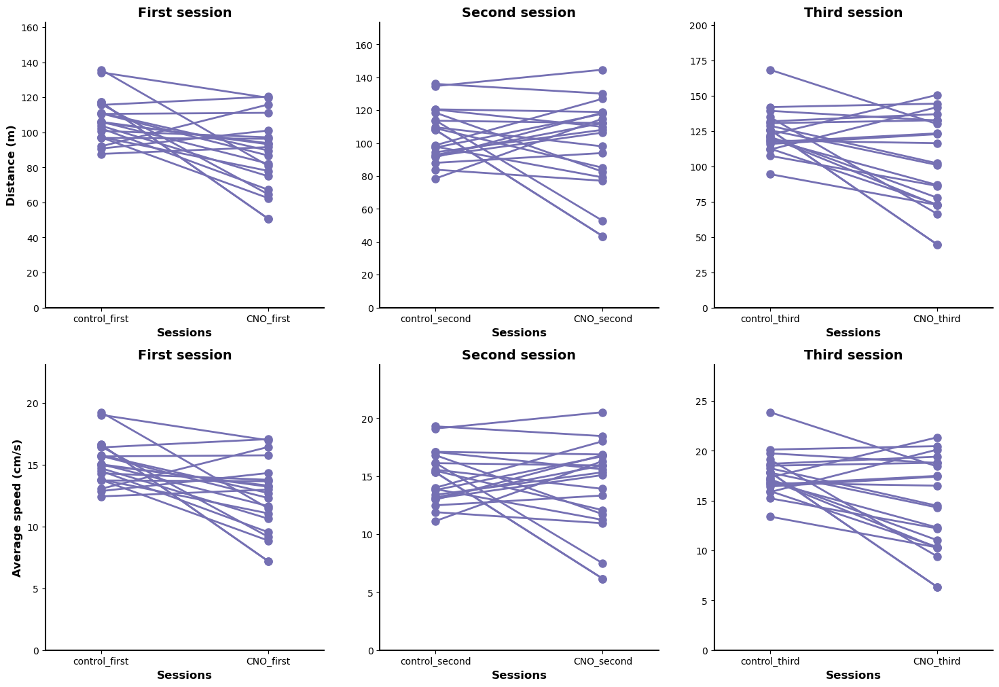

In [190]:
def compare_sessions(ax, data_dict, mice_list, session_type="first", ylabel=None):
    """
    Compare les valeurs de la session control et CNO pour la session spécifiée sous forme de points reliés.
    
    Parameters:
    - ax: L'axe sur lequel le graphique sera tracé.
    - data_dict: Le dictionnaire contenant les données à comparer (e.g., total_distances).
    - mice_list: Liste des souris à analyser.
    - session_type: "first", "second" ou "third", la session à comparer (CNO et control).
    - ylabel: Label de l'axe Y pour le graphique.
    """
    control_session = f"control_{session_type}"
    CNO_session = f"CNO_{session_type}"
    
    # Stocker les données de toutes les souris
    control_data = []
    CNO_data = []
    
    for mouse in mice_list:
        if control_session in data_dict[mouse] and CNO_session in data_dict[mouse]:
            control_data.append(data_dict[mouse][control_session])
            CNO_data.append(data_dict[mouse][CNO_session])
        else:
            print(f"Avertissement : données manquantes pour {mouse} dans {control_session} ou {CNO_session}.")
    
    # Créer un plot
    sessions = [control_session, CNO_session]
    tick_positions = [0.2, 0.8]

    # Tracer les points pour chaque souris
    for i in range(len(control_data)):
        data = [control_data[i], CNO_data[i]]
        ax.plot(tick_positions, data, color='#7570b3', linewidth=2, linestyle='-', marker='o', markersize=8)
    
    # Ajouter des titres et des labels
    ax.set_title(f'{session_type.capitalize()} session', fontsize=14, fontweight='bold')
    ax.set_ylabel(ylabel, fontsize=12, fontweight='bold')
    ax.set_xlabel('Sessions', fontsize=12, fontweight='bold')

    # Définir les positions des ticks sur l'axe X (à 0.2 et 0.8)
    ax.set_xticks(tick_positions)
    ax.set_xticklabels([control_session, CNO_session])

    # Limiter l'axe Y et ajouter de la marge
    ax.set_ylim(0, max(control_data + CNO_data) * 1.2)
    ax.set_xlim(0, 1)

    # Suppression des grilles pour un look plus propre
    ax.grid(False)
    
    # Améliorer la lisibilité des axes
    ax.tick_params(axis='both', which='major', labelsize=10)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_linewidth(1.5)
    ax.spines['bottom'].set_linewidth(1.5)

# Utiliser la fonction avec les modifications pour chaque session et chaque métrique
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

# Comparer les sessions en appelant la fonction pour chaque paire
compare_sessions(axs[0, 0], total_distances, mice_list, session_type="first", ylabel='Distance (m)')
compare_sessions(axs[0, 1], total_distances, mice_list, session_type="second", ylabel=None)
compare_sessions(axs[0, 2], total_distances, mice_list, session_type = "third", ylabel = None)
compare_sessions(axs[1, 0], average_speeds, mice_list, session_type="first", ylabel='Average speed (cm/s)')
compare_sessions(axs[1, 1], average_speeds, mice_list, session_type="second", ylabel=None)
compare_sessions(axs[1, 2], average_speeds, mice_list, session_type = "third", ylabel = None)



In [218]:
# Définir les groupes

groups = {
    "D1 DLS": UL_Gq_D1_DLS,
    "D2 DLS": UL_Gq_D2_DLS,
    "D1 DMS": UL_Gq_D1_DMS,
    "D2 DMS": UL_Gq_D2_DMS,
    "D1 dS": UL_Gq_D1_dS,
    "D2 dS": UL_Gq_D2_dS
}

In [192]:
print(total_distances['MOU4551'])

{'control_first': 97.09605517708523, 'CNO_first': 62.420136887911184, 'control_second': 83.81977213418442, 'CNO_second': 77.09014334845341, 'control_third': 130.49042894046724, 'CNO_third': 132.56063616107184}


In [219]:
from scipy.stats import wilcoxon
import numpy as np

def run_wilcoxon_tests(data_dict, groups, session_type="first"):
    """
    Effectue un test de Wilcoxon apparié pour chaque groupe et session 
    afin de comparer les données avant et après CNO.
    
    Parameters:
    - data_dict: Dictionnaire contenant les données pour chaque souris et chaque session.
    - groups: Dictionnaire des groupes de souris.
    - session_type: La session à comparer ("first", "second", "third").
    
    Retourne un dictionnaire avec les résultats des tests Wilcoxon.
    """
    results = {}
    
    for group_name, group_mice in groups.items():
        control_session = f"control_{session_type}"
        CNO_session = f"CNO_{session_type}"
        
        control_data = []
        CNO_data = []
        
        # Extraire les données des souris dans le groupe
        for mouse in group_mice:
            if control_session in data_dict[mouse] and CNO_session in data_dict[mouse]:
                control_data.append(data_dict[mouse][control_session])
                CNO_data.append(data_dict[mouse][CNO_session])
            else:
                print(f"Avertissement : données manquantes pour {mouse} dans {control_session} ou {CNO_session}.")
        
        # Effectuer le test de Wilcoxon apparié
        if len(control_data) == len(CNO_data) and len(control_data) > 1:  # Vérifier que les données sont appariées et suffisantes
            stat, p_value = wilcoxon(control_data, CNO_data)
            results[group_name] = {
                'statistic': stat,
                'p_value': p_value
            }
        else:
            print(f"Avertissement : données insuffisantes ou mal appariées pour le groupe {group_name}.")
    
    return results

# Utilisation de la fonction
wilcoxon_results = run_wilcoxon_tests(total_distances, groups, session_type="first")

# Affichage des résultats
for group_name, result in wilcoxon_results.items():
    print(f"Groupe {group_name} - Test Wilcoxon:")
    print(f"  Statistique: {result['statistic']:.4f}")
    print(f"  Valeur p: {result['p_value']:.4f}")
    if result['p_value'] < 0.05:
        print(f"  Résultat significatif (p < 0.05)\n")
    else:
        print(f"  Pas de différence significative (p >= 0.05)\n")


Groupe D1 DLS - Test Wilcoxon:
  Statistique: 0.0000
  Valeur p: 0.5000
  Pas de différence significative (p >= 0.05)

Groupe D2 DLS - Test Wilcoxon:
  Statistique: 0.0000
  Valeur p: 0.1250
  Pas de différence significative (p >= 0.05)

Groupe D1 DMS - Test Wilcoxon:
  Statistique: 7.0000
  Valeur p: 1.0000
  Pas de différence significative (p >= 0.05)

Groupe D2 DMS - Test Wilcoxon:
  Statistique: 1.0000
  Valeur p: 0.1250
  Pas de différence significative (p >= 0.05)

Groupe D1 dS - Test Wilcoxon:
  Statistique: 0.0000
  Valeur p: 0.5000
  Pas de différence significative (p >= 0.05)

Groupe D2 dS - Test Wilcoxon:
  Statistique: 0.0000
  Valeur p: 0.5000
  Pas de différence significative (p >= 0.05)



In [220]:
wilcoxon_results = run_wilcoxon_tests(total_distances, groups, session_type="first")
print(wilcoxon_results)

{'D1 DLS': {'statistic': 0.0, 'p_value': 0.5}, 'D2 DLS': {'statistic': 0.0, 'p_value': 0.125}, 'D1 DMS': {'statistic': 7.0, 'p_value': 1.0}, 'D2 DMS': {'statistic': 1.0, 'p_value': 0.125}, 'D1 dS': {'statistic': 0.0, 'p_value': 0.5}, 'D2 dS': {'statistic': 0.0, 'p_value': 0.5}}


/tmp/ipykernel_7823/159412939.py:117: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


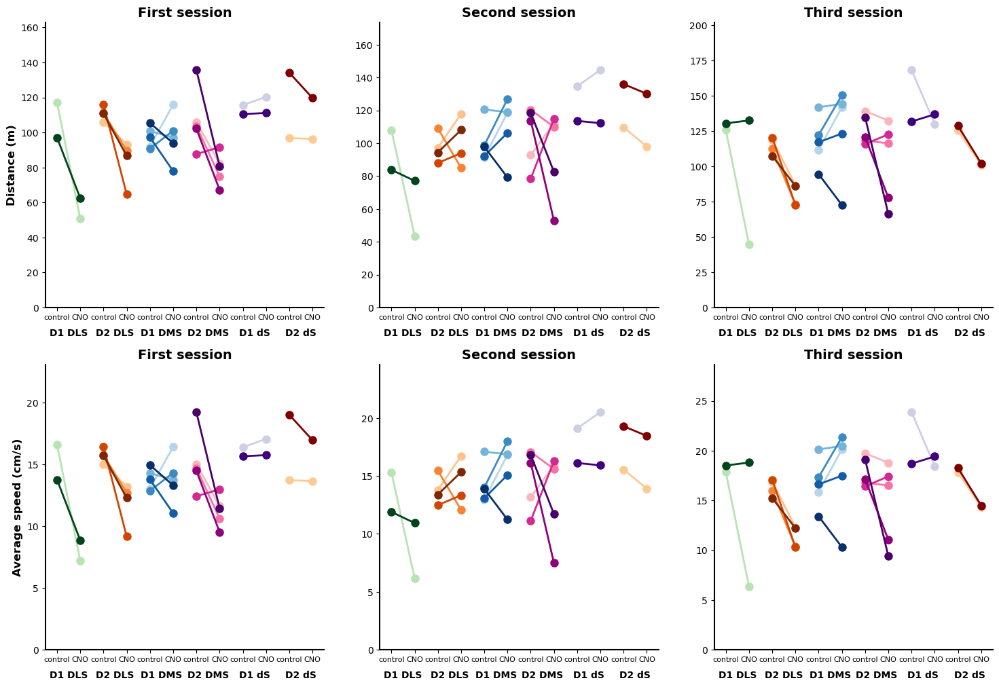

In [227]:
def compare_sessions_by_group(ax, data_dict, groups, session_type="first", ylabel=None):
    """
    Compare les valeurs des sessions control et CNO pour chaque groupe sous forme de points reliés.
    
    Parameters:
    - ax: L'axe sur lequel le graphique sera tracé.
    - data_dict: Le dictionnaire contenant les données à comparer (e.g., total_distances).
    - groups: Dictionnaire des groupes de souris à analyser, avec le nom du groupe comme clé et la liste des souris comme valeur.
    - session_type: "first", "second" ou "third", la session à comparer (CNO et control).
    - ylabel: Label de l'axe Y pour le graphique.
    """
    control_session = f"control_{session_type}"
    CNO_session = f"CNO_{session_type}"
    
    tick_positions = []
    session_labels = []
    group_annotations = []

    # Définir les colormaps pour chaque groupe

    colormaps = {
        "D1 DLS": "Greens",
        "D2 DLS": "Oranges",
        "D1 DMS": "Blues",
        "D2 DMS": "RdPu",
        "D1 dS":"Purples",
        "D2 dS":"OrRd"
    }

    # Calculate Wilcoxon results for each group
    wilcoxon_results = run_wilcoxon_tests(data_dict, groups, session_type)
    # print(wilcoxon_results) # Debugging line

    # Déterminer les positions des sessions pour chaque groupe
    for i, (group_name, group_mice) in enumerate(groups.items()):
        group_control_data = []
        group_CNO_data = []
        
        # Extraire les données pour chaque souris du groupe
        for mouse in group_mice:
            if control_session in data_dict[mouse] and CNO_session in data_dict[mouse]:
                group_control_data.append(data_dict[mouse][control_session])
                group_CNO_data.append(data_dict[mouse][CNO_session])
            else:
                print(f"Avertissement : données manquantes pour {mouse} dans {control_session} ou {CNO_session}.")

        # Position des ticks pour le groupe (2 par groupe : "control" et "CNO")
        control_position = i * 2
        CNO_position = i * 2 + 1
        
        # Enregistrer les positions et labels pour chaque session
        tick_positions.extend([control_position, CNO_position])
        session_labels.extend(["control", "CNO"])
        
        # Ajouter une annotation pour le groupe centré entre control et CNO
        group_annotations.append((control_position + 0.5, group_name))  # Centre des positions control et CNO

        # Récupérer la colormap correspondante pour le groupe
        cmap = plt.get_cmap(colormaps.get(group_name))
        colors= cmap(np.linspace(0.3, 1, len(group_mice)))
        
        # Tracer les points pour chaque souris du groupe
        for j in range(len(group_control_data)):
            data = [group_control_data[j], group_CNO_data[j]]
            ax.plot([control_position, CNO_position], data, color=colors[j], linewidth=2, linestyle='-', marker='o', markersize=8)

        p_value = wilcoxon_results.get(group_name, {}).get('p_value', None)
        # print(f"Group: {group_name}, p-value: {p_value}") # Debugging line
        if p_value is not None and p_value < 0.05:
            y_limit_upper = ax.get_ylim()[1]
            star_position_y = y_limit_upper * 0.98
            ax.text(control_position+0.5, star_position_y, '*', ha='center', fontsize=14, fontweight='bold')
    
    # Ajouter des titres et des labels
    ax.set_title(f'{session_type.capitalize()} session', fontsize=14, fontweight='bold')
    ax.set_ylabel(ylabel, fontsize=12, fontweight='bold')
    # ax.set_xlabel('Sessions', fontsize=12, fontweight='bold')

    # Définir les positions et labels des ticks sur l'axe X (pour chaque session)
    ax.set_xticks(tick_positions)
    ax.set_xticklabels(session_labels)

    # Limiter l'axe Y pour ajouter de la marge
    all_data = [value for group_mice in groups.values() for mouse in group_mice
                for value in [data_dict[mouse].get(control_session), data_dict[mouse].get(CNO_session)]
                if value is not None]
    ax.set_ylim(0, max(all_data) * 1.2)
    ax.set_xlim(-0.5, len(groups) * 2 - 0.5)

    # Ajouter les annotations pour les groupes sous chaque paire de ticks
    for pos, group_name in group_annotations:
        ax.annotate(group_name, xy=(pos, -0.1), xycoords=('data', 'axes fraction'), ha='center', 
                    fontsize=10, fontweight='bold')
    
    # Suppression des grilles pour un look plus propre
    ax.grid(False)
    
    # Améliorer la lisibilité des axes
    ax.tick_params(axis='y', which='major', labelsize=10)
    ax.tick_params(axis='x', which='major', labelsize=8)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_linewidth(1.5)
    ax.spines['bottom'].set_linewidth(1.5)

# Utiliser gridspec_kw pour ajuster l'espacement vertical
fig, axs = plt.subplots(2, 3, figsize=(18, 12), gridspec_kw={'hspace': 0.2})

# Comparer les sessions en appelant la fonction pour chaque paire
compare_sessions_by_group(axs[0, 0], total_distances, groups, session_type="first", ylabel='Distance (m)')
compare_sessions_by_group(axs[0, 1], total_distances, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[0, 2], total_distances, groups, session_type="third", ylabel=None)
compare_sessions_by_group(axs[1, 0], average_speeds, groups, session_type="first", ylabel='Average speed (cm/s)')
compare_sessions_by_group(axs[1, 1], average_speeds, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[1, 2], average_speeds, groups, session_type="third", ylabel=None)

plt.tight_layout()
plt.show()

### First : comparison of parameter regarding all epochs types

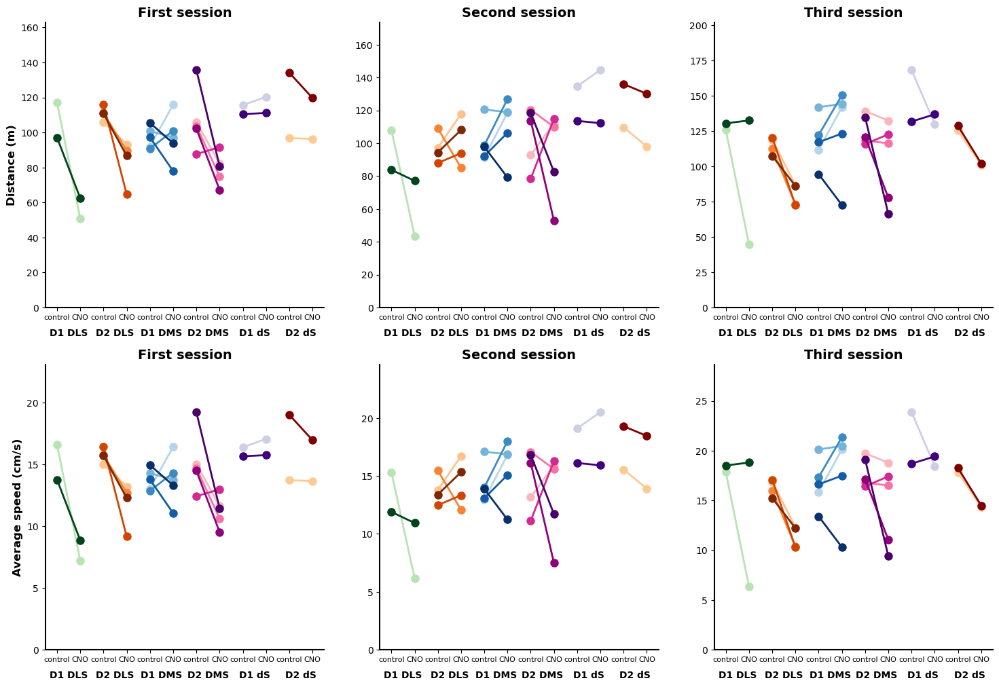

In [228]:
# Exemple d'utilisation avec 2 lignes et 2 colonnes

# Créer une figure avec 2 lignes et 2 colonnes
fig, axs = plt.subplots(2, 3, figsize=(18, 12), gridspec_kw={'hspace': 0.2})

compare_sessions_by_group(axs[0, 0], total_distances, groups, session_type="first", ylabel='Distance (m)')
compare_sessions_by_group(axs[0, 1], total_distances, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[0, 2], total_distances, groups, session_type="third", ylabel=None)
compare_sessions_by_group(axs[1, 0], average_speeds, groups, session_type="first", ylabel='Average speed (cm/s)')
compare_sessions_by_group(axs[1, 1], average_speeds, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[1, 2], average_speeds, groups, session_type="third", ylabel=None)

plt.show()


In [197]:
# Time/distance zones
# TO DO : add it in batch_trajectory processing

### Second : QT metrics

In [229]:
# distance, time, mean speed, max speed
# Initialize counters and lists for run analysis

total_time_QT_dict = {}
total_distance_QT_dict = {}
meanspeed_QT_dict = {}
maxspeed_QT_dict = {}

for mouse in mice_list:
    total_time_QT_dict[mouse] = {}
    total_distance_QT_dict[mouse] = {}
    meanspeed_QT_dict[mouse] = {}
    maxspeed_QT_dict[mouse] = {}

    for control_session, CNO_session in session_pairs:
        for session_type in (control_session, CNO_session):

            total_time_QT = 0
            total_distance_QT = 0
            meanspeed_QT = []
            maxspeed_QT = []

            for run in runs_around_tower_dict[mouse][session_type]:
                start_index, end_index = run[0][0], run[0][1]
                run_X_position = X_positions_dict[mouse][session_type][start_index:end_index + 1]
                run_Y_position = Y_positions_dict[mouse][session_type][start_index:end_index + 1]
                run_duration = traject_time_dict[mouse][session_type][end_index] - traject_time_dict[mouse][session_type][start_index]
                distance_ran = np.sum(distances_dict[mouse][session_type][start_index:end_index])

                # Accumulate metrics
                total_time_QT += run_duration
                total_distance_QT += distance_ran
                meanspeed_QT.append(distance_ran / run_duration)
                maxspeed_QT.append(np.max(speeds_dict[mouse][session_type][start_index:end_index]))

            # Store results for this session in the dictionaries
            total_time_QT_dict[mouse][session_type] = total_time_QT
            total_distance_QT_dict[mouse][session_type] = total_distance_QT
            meanspeed_QT_dict[mouse][session_type] = np.mean(meanspeed_QT)
            maxspeed_QT_dict[mouse][session_type] = np.max(maxspeed_QT)

print(maxspeed_QT_dict)


{'MOU3867': {'control_first': 65.7160881072611, 'CNO_first': 51.65230117267671, 'control_second': 59.435578378509135, 'CNO_second': 50.001673935932956, 'control_third': 68.15174647931667, 'CNO_third': 51.74737876731672}, 'MOU4551': {'control_first': 68.76498694191196, 'CNO_first': 48.22004350932219, 'control_second': 69.49921190381625, 'CNO_second': 37.26213301539478, 'control_third': 74.64062752141218, 'CNO_third': 66.58899256516378}, 'MOU4623': {'control_first': 75.5527704693093, 'CNO_first': 23.402339687797173, 'control_second': 71.57589340105375, 'CNO_second': 32.80640637267824, 'control_third': 93.10043613458421, 'CNO_third': 43.16761634232162}, 'MOU4562': {'control_first': 69.91570209144209, 'CNO_first': 76.56976391000521, 'control_second': 86.15523242724004, 'CNO_second': 60.09052797647608, 'control_third': 78.21939898082798, 'CNO_third': 55.60566353524415}, 'MOU4560': {'control_first': 72.21995270592788, 'CNO_first': 49.89879740625511, 'control_second': 69.13470655256211, 'CNO_

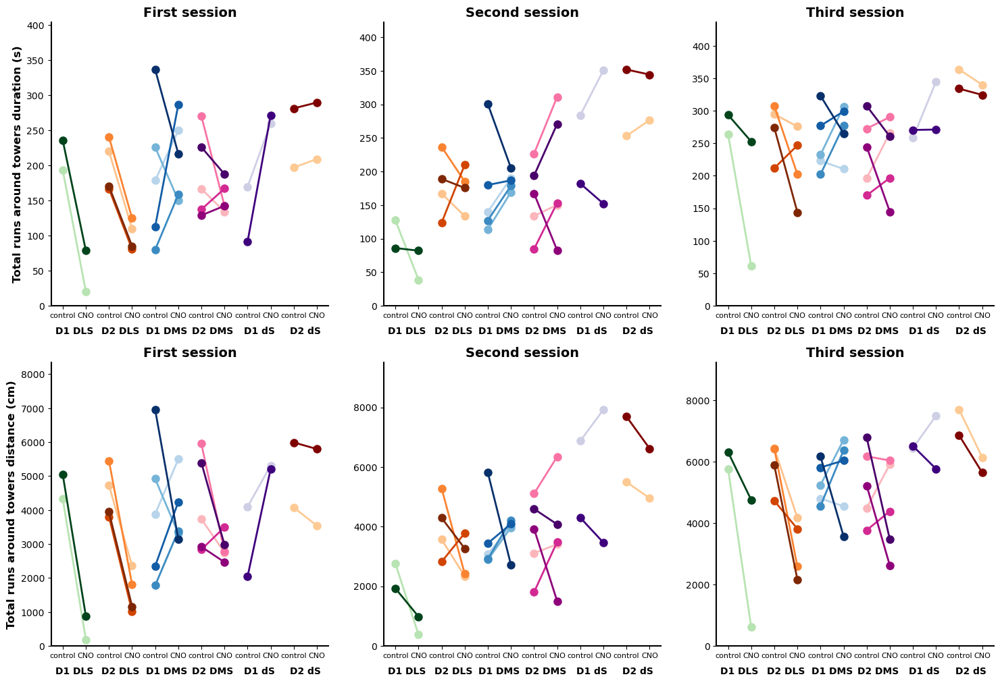

In [230]:
# total runs around towers duration/distance

# Créer une figure avec 2 lignes et 2 colonnes
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

compare_sessions_by_group(axs[0, 0], total_time_QT_dict, groups, session_type="first", ylabel='Total runs around towers duration (s)')
compare_sessions_by_group(axs[0, 1], total_time_QT_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[0, 2], total_time_QT_dict, groups, session_type="third", ylabel=None)

compare_sessions_by_group(axs[1, 0], total_distance_QT_dict, groups, session_type="first", ylabel='Total runs around towers distance (cm)')
compare_sessions_by_group(axs[1, 1], total_distance_QT_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[1, 2], total_distance_QT_dict, groups, session_type="third", ylabel=None)

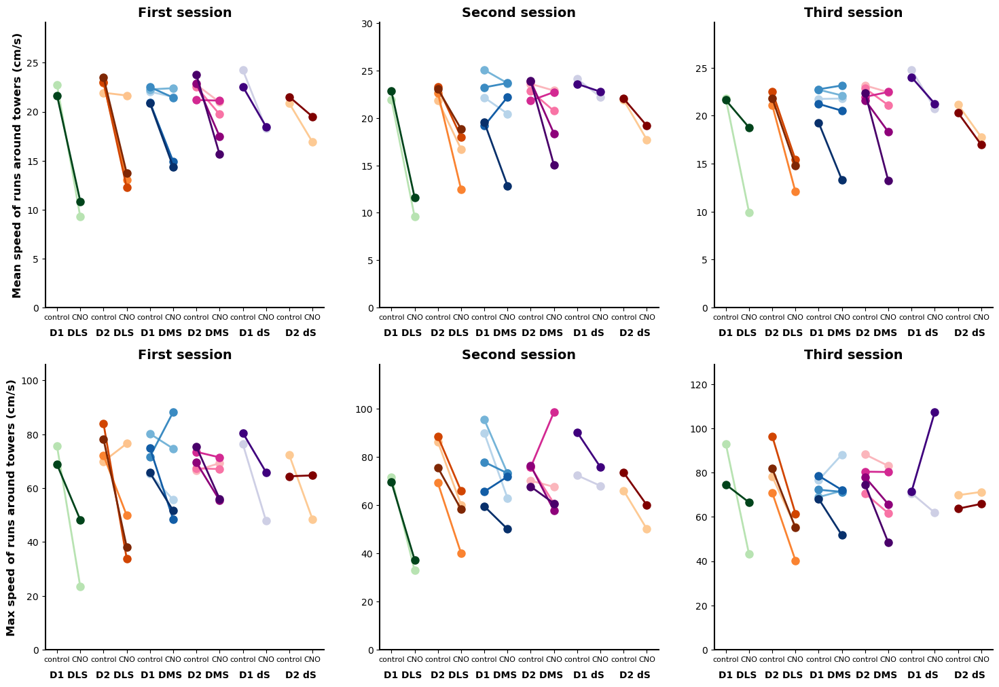

In [231]:
# mean speed, max speed

# Créer une figure avec 2 lignes et 2 colonnes
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

compare_sessions_by_group(axs[0, 0], meanspeed_QT_dict, groups, session_type="first", ylabel='Mean speed of runs around towers (cm/s)')
compare_sessions_by_group(axs[0, 1], meanspeed_QT_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[0, 2], meanspeed_QT_dict, groups, session_type="third", ylabel=None)

compare_sessions_by_group(axs[1, 0], maxspeed_QT_dict, groups, session_type="first", ylabel='Max speed of runs around towers (cm/s)')
compare_sessions_by_group(axs[1, 1], maxspeed_QT_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[1, 2], maxspeed_QT_dict, groups, session_type="third", ylabel=None)


In [246]:
# Dictionnaries of CW/CCW/rewarded/unrewarded/total

total_QT_dict = {}
total_QT_rewarded_dict = {}
total_QT_unrewarded_dict = {}
total_CW_dict = {}
total_CCW_dict = {}
ratio_CW_CCW_dict = {}

for mouse in mice_list:
    total_QT_dict[mouse] = {}
    total_QT_rewarded_dict[mouse] = {}
    total_QT_unrewarded_dict[mouse] = {}
    total_CW_dict[mouse] = {}
    total_CCW_dict[mouse] = {}
    ratio_CW_CCW_dict[mouse] = {}

    for control_session, CNO_session in session_pairs:
        for session_type in (control_session, CNO_session):
            # print(run_around_tower_results_dict[session_type]['All']['rewarded_CW'])
            total_CW_rewarded = run_around_tower_results_dict[mouse][session_type]['All']['rewarded_CW']
            total_CCW_rewarded = run_around_tower_results_dict[mouse][session_type]['All']['rewarded_CCW']
            total_CW = run_around_tower_results_dict[mouse][session_type]['All']['total_CW']
            total_CCW = run_around_tower_results_dict[mouse][session_type]['All']['total_CCW']
            
            total_QT = total_CW + total_CCW
            total_QT_rewarded = total_CW_rewarded + total_CCW_rewarded
            total_QT_unrewarded = total_QT - total_QT_rewarded
            ratio_CW_CCW = (total_CW - total_CCW) / total_QT

            total_QT_dict[mouse][session_type] = total_QT
            total_QT_rewarded_dict[mouse][session_type] = total_QT_rewarded
            total_QT_unrewarded_dict[mouse][session_type] = total_QT_unrewarded
            total_CW_dict[mouse][session_type] = total_CW
            total_CCW_dict[mouse][session_type] = total_CCW
            ratio_CW_CCW_dict[mouse][session_type] = ratio_CW_CCW

print(ratio_CW_CCW_dict)
# print(run_around_tower_results_dict['control_first']['All'])


{'MOU3867': {'control_first': 0.3286384976525822, 'CNO_first': 0.7222222222222222, 'control_second': -0.7637362637362637, 'CNO_second': 0.3446327683615819, 'control_third': -0.02278481012658228, 'CNO_third': 0.2719665271966527}, 'MOU4551': {'control_first': 0.46619217081850534, 'CNO_first': 0.34177215189873417, 'control_second': -0.26605504587155965, 'CNO_second': 0.27472527472527475, 'control_third': -0.21693121693121692, 'CNO_third': 0.1349206349206349}, 'MOU4623': {'control_first': 0.23529411764705882, 'CNO_first': 0.5833333333333334, 'control_second': -0.5263157894736842, 'CNO_second': 0.782608695652174, 'control_third': 0.2618296529968454, 'CNO_third': 0.375}, 'MOU4562': {'control_first': -0.38235294117647056, 'CNO_first': -0.7251908396946565, 'control_second': 0.6, 'CNO_second': -0.6888888888888889, 'control_third': -0.30434782608695654, 'CNO_third': -0.07167235494880546}, 'MOU4560': {'control_first': -0.5663430420711975, 'CNO_first': -0.43119266055045874, 'control_second': 0.554

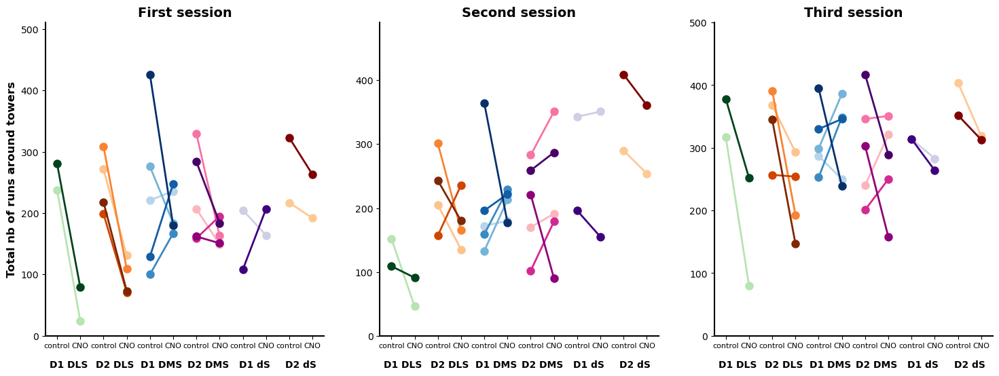

In [247]:
# Total nb of QT

# Créer une figure avec 2 lignes et 2 colonnes
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

compare_sessions_by_group(axs[0], total_QT_dict, groups, session_type="first", ylabel='Total nb of runs around towers')
compare_sessions_by_group(axs[1], total_QT_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[2], total_QT_dict, groups, session_type="third", ylabel=None)

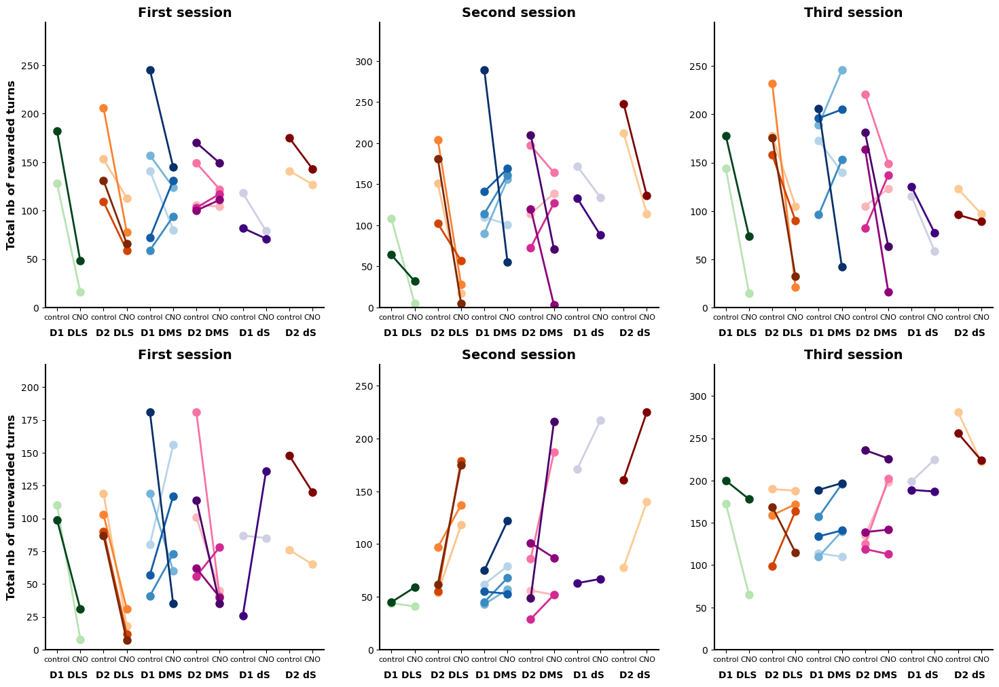

In [248]:
# rewarded, unrewarded

# Créer une figure avec 2 lignes et 2 colonnes
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

compare_sessions_by_group(axs[0, 0], total_QT_rewarded_dict, groups, session_type="first", ylabel='Total nb of rewarded turns')
compare_sessions_by_group(axs[0, 1], total_QT_rewarded_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[0, 2], total_QT_rewarded_dict, groups, session_type="third", ylabel=None)

compare_sessions_by_group(axs[1, 0], total_QT_unrewarded_dict, groups, session_type="first", ylabel='Total nb of unrewarded turns')
compare_sessions_by_group(axs[1, 1], total_QT_unrewarded_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[1, 2], total_QT_unrewarded_dict, groups, session_type="third", ylabel=None)


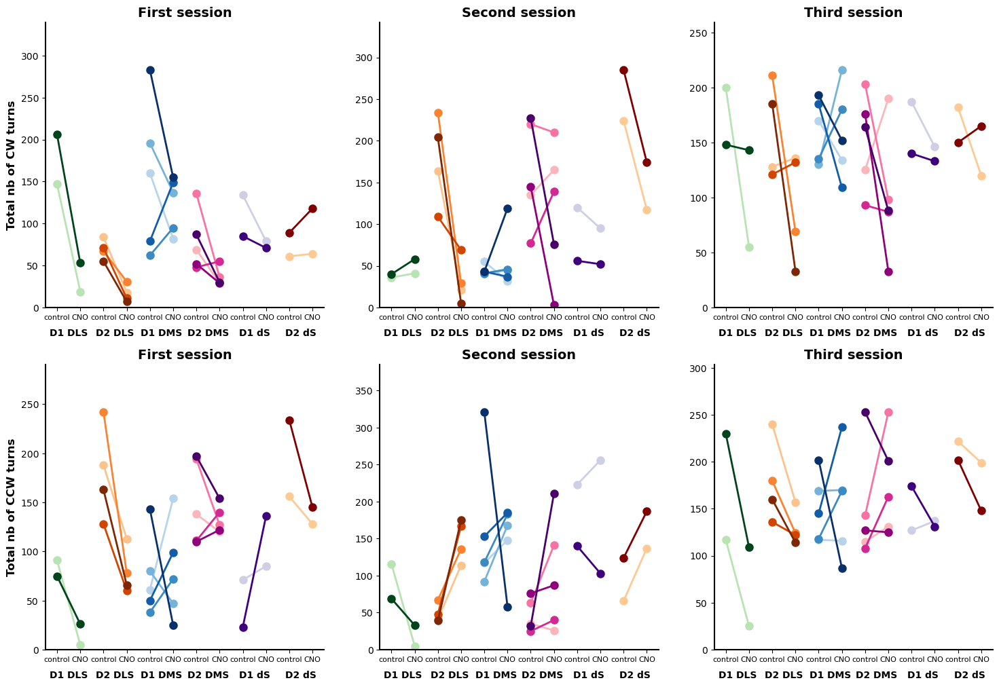

In [249]:
# nb CW / CCW

# Créer une figure avec 2 lignes et 2 colonnes
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

compare_sessions_by_group(axs[0, 0], total_CW_dict, groups, session_type="first", ylabel='Total nb of CW turns')
compare_sessions_by_group(axs[0, 1], total_CW_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[0, 2], total_CW_dict, groups, session_type="third", ylabel=None)

compare_sessions_by_group(axs[1, 0], total_CCW_dict, groups, session_type="first", ylabel='Total nb of CCW turns')
compare_sessions_by_group(axs[1, 1], total_CCW_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[1, 2], total_CCW_dict, groups, session_type="third", ylabel=None)

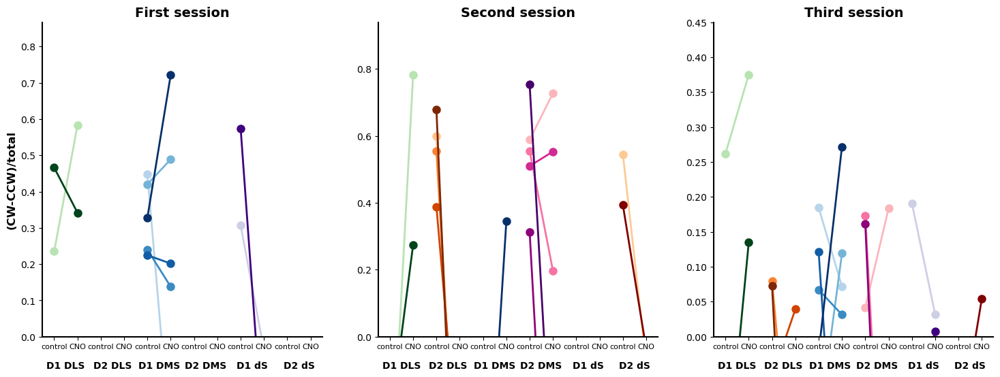

In [250]:
# ratio CW/CCW
# TO DO : add a ylim argument in function so it can go below 0

# Créer une figure avec 2 lignes et 2 colonnes
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

compare_sessions_by_group(axs[0], ratio_CW_CCW_dict, groups, session_type="first", ylabel='(CW-CCW)/total')
compare_sessions_by_group(axs[1], ratio_CW_CCW_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[2], ratio_CW_CCW_dict, groups, session_type="third", ylabel=None)


In [237]:
# Stereotypie (analyse David) for later

### Third : BT metrics

In [251]:
# distance, time, mean speed, max speed
# Initialize counters and lists for run analysis

total_time_BT_dict = {}
total_distance_BT_dict = {}
meanspeed_BT_dict = {}
maxspeed_BT_dict = {}

for mouse in mice_list:
    total_time_BT_dict[mouse] = {}
    total_distance_BT_dict[mouse] = {}
    meanspeed_BT_dict[mouse] = {}
    maxspeed_BT_dict[mouse] = {}

    for control_session, CNO_session in session_pairs:
        for session_type in (control_session, CNO_session):

            total_time_BT = 0
            total_distance_BT = 0
            meanspeed_BT = []
            maxspeed_BT = []

            for run in runs_between_towers_dict[mouse][session_type]:
                start_index, end_index = run[0][0], run[0][1]
                run_X_position = X_positions_dict[mouse][session_type][start_index:end_index + 1]
                run_Y_position = Y_positions_dict[mouse][session_type][start_index:end_index + 1]
                run_duration = traject_time_dict[mouse][session_type][end_index] - traject_time_dict[mouse][session_type][start_index]
                distance_ran = np.sum(distances_dict[mouse][session_type][start_index:end_index])

                # Accumulate metrics
                total_time_BT += run_duration
                total_distance_BT += distance_ran
                meanspeed_BT.append(distance_ran / run_duration)
                maxspeed_BT.append(np.max(speeds_dict[mouse][session_type][start_index:end_index]))

            # Store results for this session in the dictionaries
            total_time_BT_dict[mouse][session_type] = total_time_BT
            total_distance_BT_dict[mouse][session_type] = total_distance_BT
            meanspeed_BT_dict[mouse][session_type] = np.mean(meanspeed_BT)
            maxspeed_BT_dict[mouse][session_type] = np.max(maxspeed_BT)

print(maxspeed_BT_dict)

{'MOU3867': {'control_first': 59.22414293894632, 'CNO_first': 48.07601626451714, 'control_second': 72.0033138237608, 'CNO_second': 51.41906524212497, 'control_third': 62.23708487572492, 'CNO_third': 44.079083805779035}, 'MOU4551': {'control_first': 86.08399166754147, 'CNO_first': 47.09010610460134, 'control_second': 89.39134325821934, 'CNO_second': 38.71987213705021, 'control_third': 109.42895611862687, 'CNO_third': 76.31417335202346}, 'MOU4623': {'control_first': 94.09035374803287, 'CNO_first': 38.10258902403608, 'control_second': 97.5002820330628, 'CNO_second': 37.52654174472468, 'control_third': 95.226837781307, 'CNO_third': 31.621756902689782}, 'MOU4562': {'control_first': 74.79571007888075, 'CNO_first': 84.03299867439783, 'control_second': 84.93301018307116, 'CNO_second': 67.98881500881222, 'control_third': 83.45648509686004, 'CNO_third': 63.71811152664594}, 'MOU4560': {'control_first': 94.89958966720623, 'CNO_first': 40.86684615103228, 'control_second': 84.36227376861368, 'CNO_se

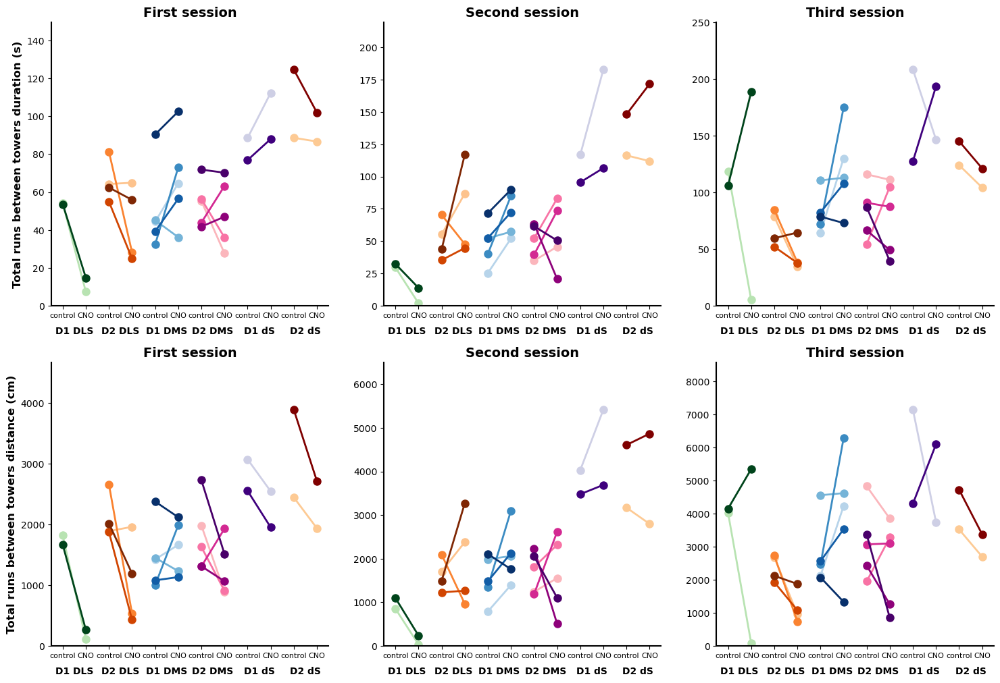

In [239]:
# total runs between towers duration/distance

# Créer une figure avec 2 lignes et 2 colonnes
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

compare_sessions_by_group(axs[0, 0], total_time_BT_dict, groups, session_type="first", ylabel='Total runs between towers duration (s)')
compare_sessions_by_group(axs[0, 1], total_time_BT_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[0, 2], total_time_BT_dict, groups, session_type="third", ylabel=None)

compare_sessions_by_group(axs[1, 0], total_distance_BT_dict, groups, session_type="first", ylabel='Total runs between towers distance (cm)')
compare_sessions_by_group(axs[1, 1], total_distance_BT_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[1, 2], total_distance_BT_dict, groups, session_type="third", ylabel=None)

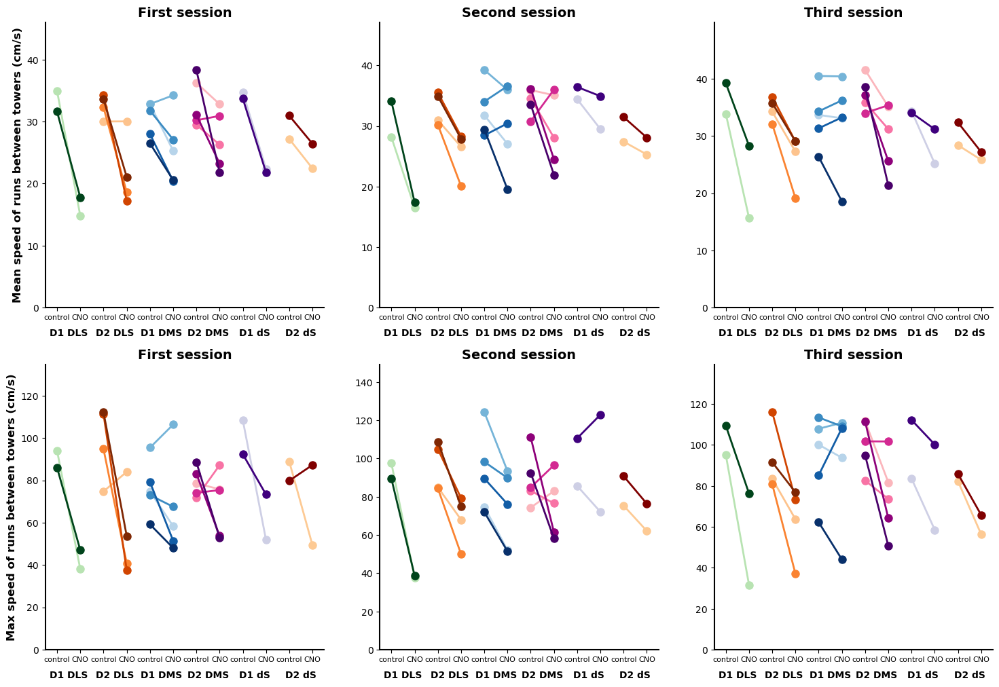

In [240]:
# mean speed, max speed

# Créer une figure avec 2 lignes et 2 colonnes
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

compare_sessions_by_group(axs[0, 0], meanspeed_BT_dict, groups, session_type="first", ylabel='Mean speed of runs between towers (cm/s)')
compare_sessions_by_group(axs[0, 1], meanspeed_BT_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[0, 2], meanspeed_BT_dict, groups, session_type="third", ylabel=None)

compare_sessions_by_group(axs[1, 0], maxspeed_BT_dict, groups, session_type="first", ylabel='Max speed of runs between towers (cm/s)')
compare_sessions_by_group(axs[1, 1], maxspeed_BT_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[1, 2], maxspeed_BT_dict, groups, session_type="third", ylabel=None)

In [241]:
# Function get_metrics_of_run_type à créer

### Fourth : exploratory runs metrics

In [242]:
# distance, time, mean speed, max speed
# Initialize counters and lists for run analysis

total_time_ER_dict = {}
total_distance_ER_dict = {}
meanspeed_ER_dict = {}
maxspeed_ER_dict = {}

for mouse in mice_list:
    total_time_ER_dict[mouse] = {}
    total_distance_ER_dict[mouse] = {}
    meanspeed_ER_dict[mouse] = {}
    maxspeed_ER_dict[mouse] = {}

    for control_session, CNO_session in session_pairs:
        for session_type in (control_session, CNO_session):

            total_time_ER = 0
            total_distance_ER = 0
            meanspeed_ER = []
            maxspeed_ER = []

            for run in exploratory_runs_dict[mouse][session_type]:
                start_index, end_index = run[0][0], run[0][1]
                run_X_position = X_positions_dict[mouse][session_type][start_index:end_index + 1]
                run_Y_position = Y_positions_dict[mouse][session_type][start_index:end_index + 1]
                run_duration = traject_time_dict[mouse][session_type][end_index] - traject_time_dict[mouse][session_type][start_index]
                distance_ran = np.sum(distances_dict[mouse][session_type][start_index:end_index])

                # Accumulate metrics
                total_time_ER += run_duration
                total_distance_ER += distance_ran
                meanspeed_ER.append(distance_ran / run_duration)
                maxspeed_ER.append(np.max(speeds_dict[mouse][session_type][start_index:end_index]))

            # Store results for this session in the dictionaries
            total_time_ER_dict[mouse][session_type] = total_time_ER
            total_distance_ER_dict[mouse][session_type] = total_distance_ER
            meanspeed_ER_dict[mouse][session_type] = np.mean(meanspeed_ER)
            maxspeed_ER_dict[mouse][session_type] = np.max(maxspeed_ER)

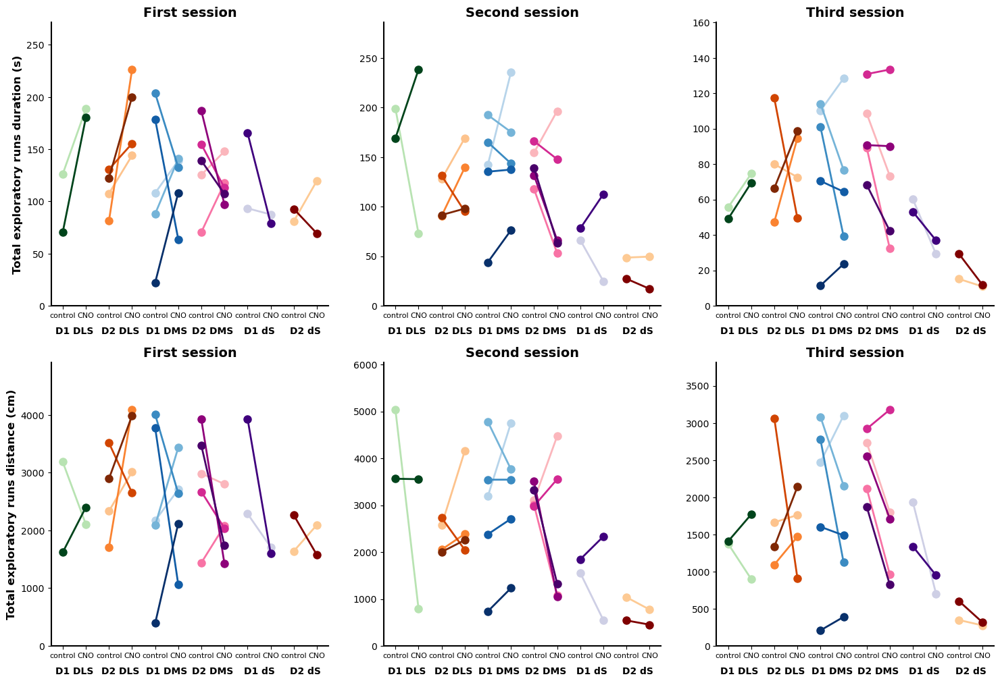

In [243]:
# total explo runs duration/distance

# Créer une figure avec 2 lignes et 2 colonnes
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

compare_sessions_by_group(axs[0, 0], total_time_ER_dict, groups, session_type="first", ylabel='Total exploratory runs duration (s)')
compare_sessions_by_group(axs[0, 1], total_time_ER_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[0, 2], total_time_ER_dict, groups, session_type="third", ylabel=None)

compare_sessions_by_group(axs[1, 0], total_distance_ER_dict, groups, session_type="first", ylabel='Total exploratory runs distance (cm)')
compare_sessions_by_group(axs[1, 1], total_distance_ER_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[1, 2], total_distance_ER_dict, groups, session_type="third", ylabel=None)

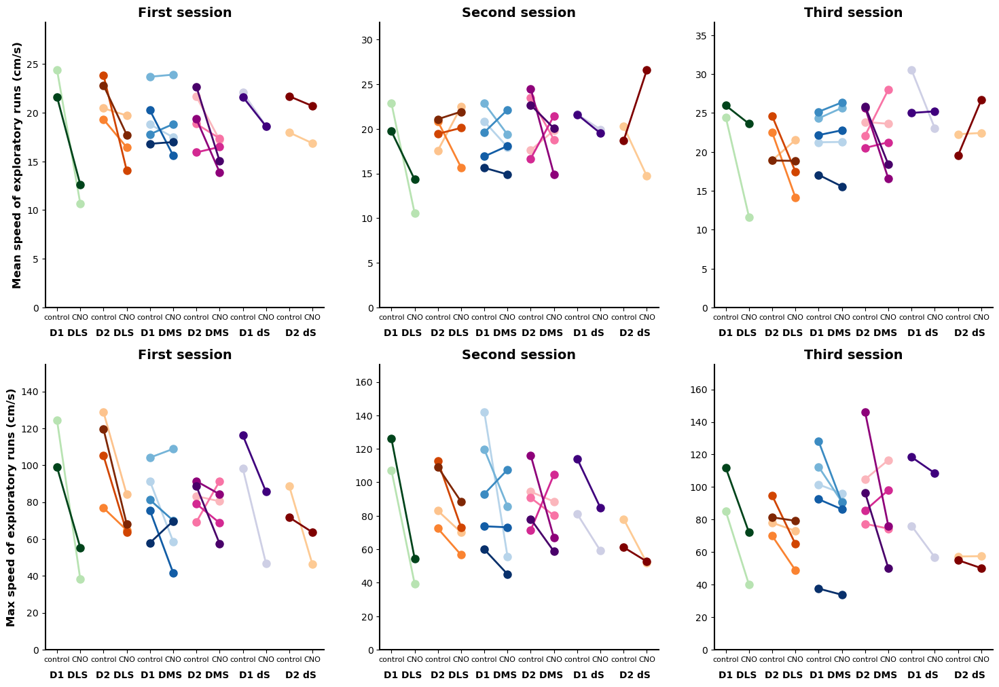

In [244]:
# mean speed, max speed

# Créer une figure avec 2 lignes et 2 colonnes
fig, axs = plt.subplots(2, 3, figsize=(18, 12))

compare_sessions_by_group(axs[0, 0], meanspeed_ER_dict, groups, session_type="first", ylabel='Mean speed of exploratory runs (cm/s)')
compare_sessions_by_group(axs[0, 1], meanspeed_ER_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[0, 2], meanspeed_ER_dict, groups, session_type="third", ylabel=None)

compare_sessions_by_group(axs[1, 0], maxspeed_ER_dict, groups, session_type="first", ylabel='Max speed of exploratory runs (cm/s)')
compare_sessions_by_group(axs[1, 1], maxspeed_ER_dict, groups, session_type="second", ylabel=None)
compare_sessions_by_group(axs[1, 2], maxspeed_ER_dict, groups, session_type="third", ylabel=None)

In [245]:
assert False, "Stopping execution here."

def generate_session_figure(fig, n_rows, n_cols, session_type):# Creation of the grid
    # Dimensions de chaque carré
    # Utilisation de GridSpec pour une grille flexible
    gs = GridSpec(n_rows, n_cols, figure=fig)

    # Insertion des graphiques dans la grille
    # Trajectoire dans la case de la colonne 2 et ligne 3
    ax_trajectory = fig.add_subplot(gs[2, 1])  # Ligne 3, colonne 2
    plot_trajectory_type_centered(ax_trajectory, X_positions_cm, Y_positions_cm, runs_between_towers, title_type='runs between towers')

    # First line, columns 1 to 4 : metrics for all session and run types

    ax_


# Taille totale de la figure
square_size = 6
n_cols = 4
n_rows = 5
figsize = (n_cols * square_size, n_rows * square_size)
# Création de la figure
fig = plt.figure(figsize=figsize)
generate_session_figure(fig, n_rows, n_cols)

# Espacement entre les sous-graphes
plt.tight_layout()
plt.show()

AssertionError: Stopping execution here.